In [1]:
%pwd
%ls

data_science_bowl.ipynb  foo.jpg                  test/
data_science_bowl.py     resample/
foo.csv                  sample_images/


In [2]:
INPUT_FOLDER = './sample_images/'
# INPUT_FOLDER = '/Volumes/MS-1TB/Data/stage1/'

In [3]:
%matplotlib inline

import numpy as np
import pandas as pd
import dicom
import os
import scipy.ndimage
import matplotlib.pyplot as plt

from skimage import measure, morphology
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

In [4]:
patients = os.listdir(INPUT_FOLDER)
patients.sort()

In [5]:
print(patients[:5])
len(patients)

['00cba091fa4ad62cc3200a657aeb957e', '0a099f2549429d29b32f349e95fb2244', '0a0c32c9e08cc2ea76a71649de56be6d', '0a38e7597ca26f9374f8ea2770ba870d', '0acbebb8d463b4b9ca88cf38431aac69']


20

In [6]:
def load_scan(path):  
    slices = [dicom.read_file(path + '/' + s) for s in os.listdir(path)]
    slices.sort(key = lambda x: float(x.ImagePositionPatient[2]))
    
    try:
        slice_thickness = np.abs(slices[0].ImagePositionPatient[2] - slices[1].ImagePositionPatient[2])
    except:
        slice_thickness = np.abs(slices[0].SliceLocation - slices[1].SliceLocation)
        
    for s in slices:
        s.SliceThickness = slice_thickness

    return slices

In [7]:
patient_0 = load_scan(INPUT_FOLDER + patients[0])

In [42]:
scans = [load_scan(INPUT_FOLDER + p) for p in patients]

# Notes

- We have about 20 patients in the sample set
- Each patient's scan is about 120 to 200 slices
    - We don't have an equal number of slices for each
    - Might need to normalize that in order to use matrices
    
- 1595 patients in the set
    



In [9]:
def get_pixels_hu(slices):
    image = np.stack([s.pixel_array for s in slices])
    image = image.astype(np.int16)
    
    image[image == -2000] = 0
    
    for slice_number in range(len(slices)):
        intercept = slices[slice_number].RescaleIntercept
        slope = slices[slice_number].RescaleSlope
    
        if slope != 1:
            image[slice_number] = slope * image[slice_number].astype(np.float64)
            image[slice_number] = image[slice_number].astype(np.int16)
            
        image[slice_number] += np.int16(intercept)
        
    return np.array(image, dtype=np.int16)
    

In [10]:
patient_0_pixels = get_pixels_hu(patient_0)

In [11]:
scan_pixels = [get_pixels_hu(s) for s in scans]

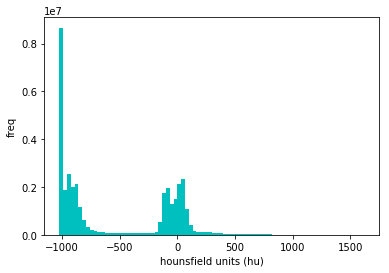

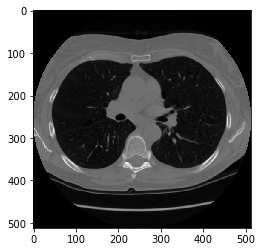

In [12]:
plt.hist(patient_0_pixels.flatten(), bins=80, color='c')
plt.xlabel("hounsfield units (hu)")
plt.ylabel("freq")
plt.show()

plt.imshow(patient_0_pixels[80], cmap=plt.cm.gray)
plt.show()

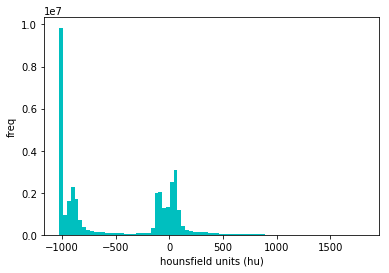

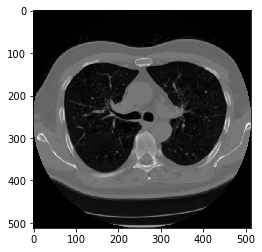

In [13]:
plt.hist(scan_pixels[2].flatten(), bins=80, color='c')
plt.xlabel("hounsfield units (hu)")
plt.ylabel("freq")
plt.show()

plt.imshow(scan_pixels[2][80], cmap=plt.cm.gray)
plt.show()

# Resampling

In [14]:
def resample(image, scan, new_spacing=[1,1,1]):
    spacing = np.array([scan[0].SliceThickness] + scan[0].PixelSpacing, dtype=np.float32)
    
    resize_factor = spacing / new_spacing
    new_real_shape = image.shape * resize_factor
    new_shape = np.round(new_real_shape)
    real_resize_factor = new_shape / image.shape
    new_spacing = spacing / real_resize_factor
    
    image = scipy.ndimage.interpolation.zoom(image, real_resize_factor, mode='nearest')
    
#     return image, new_spacing
    return image

In [15]:
# patient_0_pix_resampled, patient_0_pix_spacing = resample(patient_0_pixels, patient_0)
patient_0_pix_resampled = resample(patient_0_pixels, patient_0)

In [16]:
scan_pixels_resampled = []
n = len(scans)
for i in range(0, n):
    scan_pixels_resampled.append(resample(scan_pixels[i], scans[i]))

In [17]:
print("Shape before resampling\t", patient_0_pixels.shape)
print("Shape after resampling\t", patient_0_pix_resampled.shape)

('Shape before resampling\t', (134, 512, 512))
('Shape after resampling\t', (335, 306, 306))


('Shape before resampling\t', (275, 320, 320))
('Shape after resampling\t', (275, 320, 320))


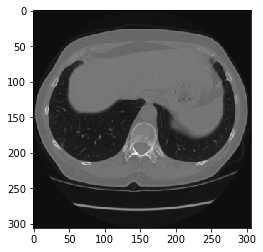

In [18]:
print("Shape before resampling\t", scan_pixels_resampled[3].shape)
print("Shape after resampling\t", scan_pixels_resampled[3].shape)

plt.imshow(scan_pixels_resampled[0][80], cmap=plt.cm.gray)
plt.show()

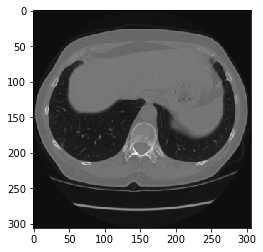

In [19]:
plt.imshow(patient_0_pix_resampled[80], cmap=plt.cm.gray)
plt.show()

In [20]:
def plot_3d(image, threshold=-300):
    p = image.transpose(2,1,0)
    
    verts, faces = measure.marching_cubes(p, threshold)
    
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')
    
    mesh = Poly3DCollection(verts[faces], alpha=0.70)
    face_color = [0.45, 0.45, 0.75]
    mesh.set_facecolor(face_color)
    ax.add_collection3d(mesh)
    
    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])
    
    plt.show()

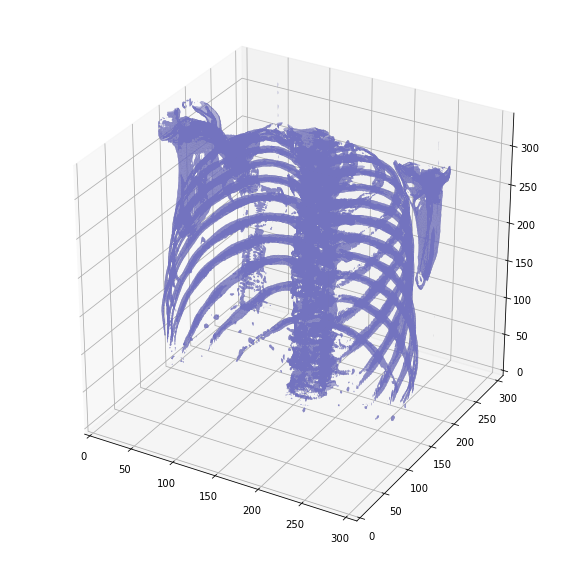

In [90]:
plot_3d(patient_0_pix_resampled, 400)

In [22]:
def largest_label_volume(im, bg=-1):
    vals, counts = np.unique(im, return_counts=True)
    
    counts = counts[vals != bg]
    vals = vals[vals != bg]
    
    if len(counts) > 0:
        return vals[np.argmax(counts)]
    else:
        return None        

In [23]:
def segment_lung_mask(image, fill_lung_structures=True):
    binary_image = np.array(image > -320, dtype=np.int8)+1
    labels = measure.label(binary_image)
    
    background_label = labels[0,0,0]
    
    binary_image[background_label == labels] = 2
    
    if fill_lung_structures:
        for i, axial_slice in enumerate(binary_image):
            axial_slicee = axial_slice - 1
            labeling = measure.label(axial_slice)
            l_max = largest_label_volume(labeling, bg=0)
            
            if l_max is not None:
                binary_image[i][labeling != l_max] = 1
                
                
    binary_image -= 1
    binary_image = 1 - binary_image
    
    labels = measure.label(binary_image, background=0)
    l_max = largest_label_volume(labels, bg=0)
    
    if l_max is not None:
        binary_image[labels != l_max] = 0
    
    return binary_image

In [24]:
patient_0_seg_lungs = segment_lung_mask(patient_0_pix_resampled, False)

In [25]:
patient_0_seg_lungs_fill = segment_lung_mask(patient_0_pix_resampled, True)

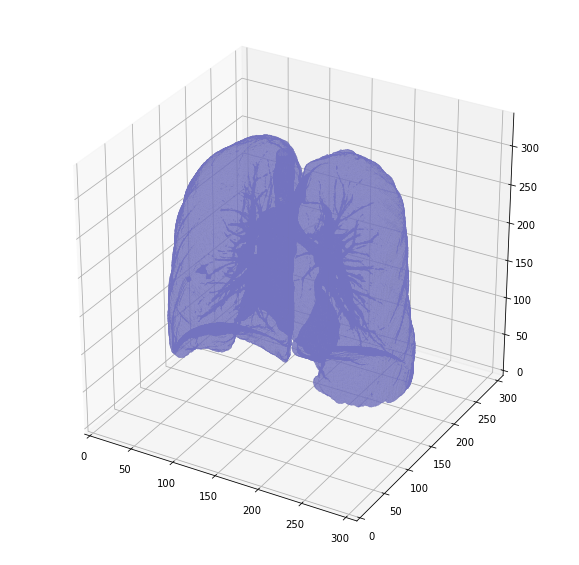

In [103]:
plot_3d(patient_0_seg_lungs, 0)

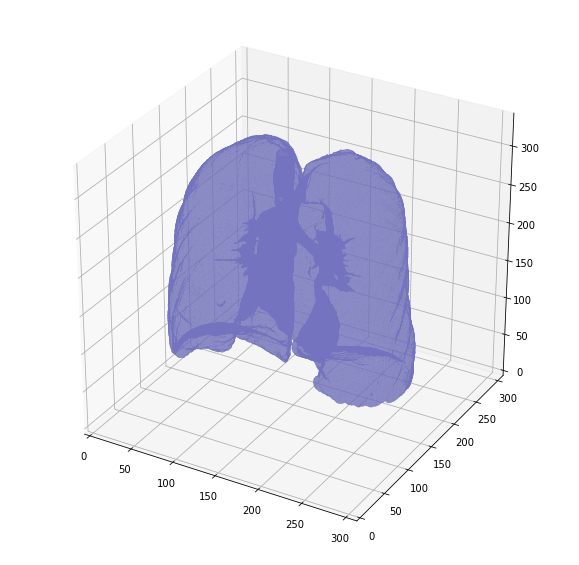

In [104]:
plot_3d(patient_0_seg_lungs_fill, 0)

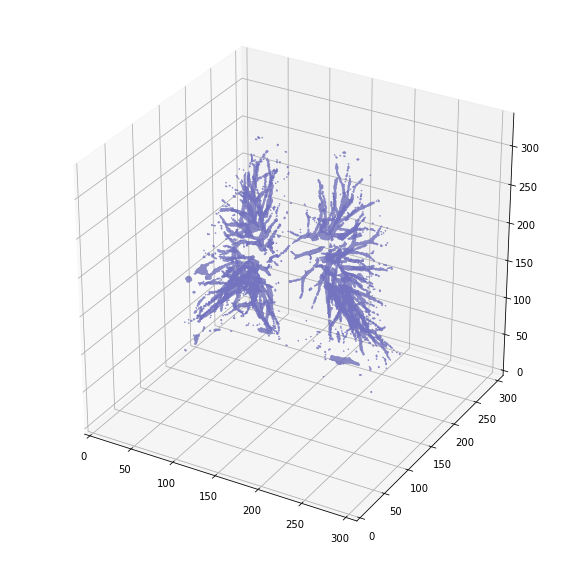

In [106]:
plot_3d(patient_0_seg_lungs_fill - patient_0_seg_lungs, 0)

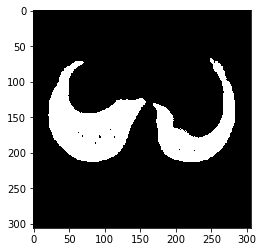

In [26]:
plt.imshow(patient_0_seg_lungs[80], cmap=plt.cm.gray)
plt.show()

In [27]:
len(patient_0_seg_lungs)

335

In [28]:
scan_pixels_seg_lungs = [segment_lung_mask(sr, False) for sr in scan_pixels_resampled]

In [29]:
scan_pixels_seg_lungs_fill = [segment_lung_mask(sr, True) for sr in scan_pixels_resampled]

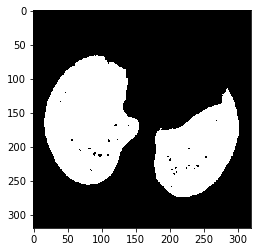

In [30]:
plt.imshow(scan_pixels_seg_lungs[3][80], cmap=plt.cm.gray)
plt.show()

In [31]:
len(scan_pixels_seg_lungs)

20

In [32]:
scan_pixels_seg_lungs[0]

array([[[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ..., 
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ..., 
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ..., 
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       ..., 
       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ..., 
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]],

       [[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ..., 
        [0, 0, 0, 

In [33]:
print("Finished")

Finished


In [45]:
patient_0[0].pixel_array

array([[-2000, -2000, -2000, ..., -2000, -2000, -2000],
       [-2000, -2000, -2000, ..., -2000, -2000, -2000],
       [-2000, -2000, -2000, ..., -2000, -2000, -2000],
       ..., 
       [-2000, -2000, -2000, ..., -2000, -2000, -2000],
       [-2000, -2000, -2000, ..., -2000, -2000, -2000],
       [-2000, -2000, -2000, ..., -2000, -2000, -2000]], dtype=int16)

In [39]:
m = len(patient_0)
# plt.imshow(patient_0[0].pixel_array, interpolation='nearest')
for i in range(0, m):
#     print(i)
    plt.figure(figsize=(3,3))
    plt.axes([0,0,1,1])
    plt.axis('off')
    plt.imshow(patient_0[i].pixel_array, cmap=plt.cm.gray)
    filename = "{0:0=3d}".format(i)
    plt.savefig("test/" + filename + ".jpg",bbox_inches=0)
    plt.close()


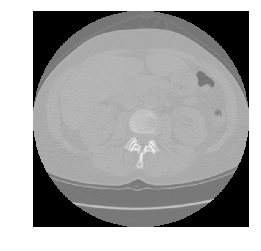

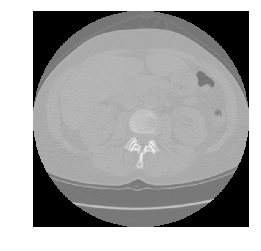

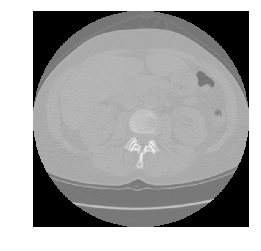

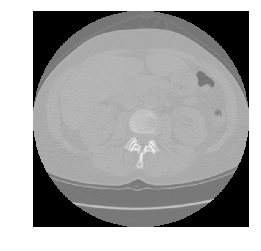

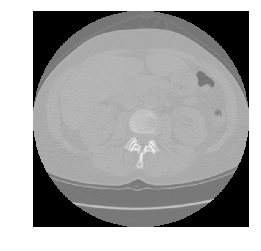

...

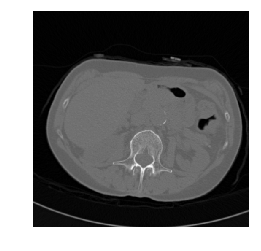

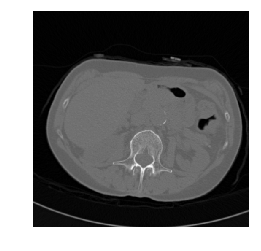

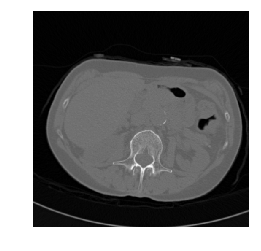

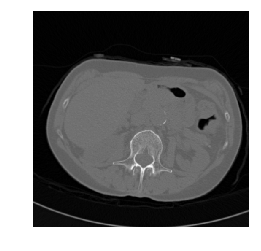

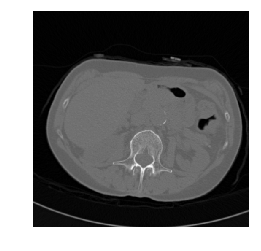

In [ ]:
for scan in scans:
    k = len(scan)
    patientname = scan[0].PatientsName
    for i in range(0, k):
        plt.figure(figsize=(3,3))
        plt.axes([0,0,1,1])
        plt.axis('off')
        plt.imshow(scan[0].pixel_array, cmap=plt.cm.gray)
        filename = "{0:0=3d}".format(i)
        plt.savefig("resample/" + patientname + "/" + filename + ".jpg",bbox_inches=0)
        plt.close()

In [46]:
scans[0][0].PatientsName

'00cba091fa4ad62cc3200a657aeb957e'